In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
import torch
import torch.nn as nn
from glob import glob
from os.path import expanduser, join, basename, dirname
import xarray as xr
import numpy as np
from tqdm import tqdm
import pandas as pd
import matplotlib.pyplot as plt
from joblib import Parallel, delayed
from itertools import product
from torch.utils.data import TensorDataset, DataLoader
from astra.torch.models import EfficientNetClassifier,EfficientNet_B0_Weights
from astra.torch.utils import train_fn

import torchvision.models as models
from astra.torch.metrics import accuracy_score, f1_score, precision_score, recall_score,classification_report

In [2]:
loaded_data1 = torch.load("/home/rishabh.mondal/Brick-Kilns-project/albk_rishabh/tensor_data/lucknow_grid_data.pt")
images = loaded_data1['images']
#print shape of tensors
images = images / 255
    # mean normalize
images = (images - images.mean(dim=(0, 2, 3), keepdim=True)) / images.std(dim=(0, 2, 3), keepdim=True)



In [3]:
# images = images.permute(0, 2 , 3, 1)
images.shape


torch.Size([87025, 3, 224, 224])

In [4]:
labels = torch.zeros(87025)


In [5]:
images.shape

torch.Size([87025, 3, 224, 224])

In [6]:
testdataset = TensorDataset(images, labels)
testloader = DataLoader(testdataset, batch_size=512, shuffle=False, num_workers=8)

In [7]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [8]:
train_model = EfficientNetClassifier(
    models.efficientnet_b0,None, n_classes=2, activation=nn.ReLU(), dropout=0.1
).to(device)

In [9]:
train_model.load_state_dict(torch.load("/home/rishabh.mondal/Brick-Kilns-project/albk_rishabh/Saved_model/delhi_whole_data_pretrain_aug.pt"))

<All keys matched successfully>

In [11]:
with torch.no_grad():
    pred_classes =train_model.predict_class(
        dataloader=testloader, batch_size=512, verbose=True
    ).to(device)


100%|██████████| 170/170 [00:31<00:00,  5.40it/s]


In [12]:
zero_predictions = torch.sum(pred_classes == 0)
one_predictions = torch.sum(pred_classes == 1)

print("Number of zero predictions:", zero_predictions.item())
print("Number of one predictions:", one_predictions.item())


Number of zero predictions: 86435
Number of one predictions: 590


In [10]:
from torchvision import transforms


In [13]:
# train_model='/home/rishabh.mondal/Brick-Kilns-project/albk_rishabh/Saved_model/delhi_whole_data_train_model.pt'
positive_image_indices = []
save_dir = '/home/rishabh.mondal/Brick-Kilns-project/albk_rishabh/predicted_positive/lucknow_grid'
os.makedirs(save_dir, exist_ok=True)

with torch.no_grad():
    pred_classes =train_model.predict_class(
        dataloader=testloader, batch_size=512, verbose=True
    ).to(device)

zero_predictions = torch.sum(pred_classes == 0)
one_predictions = torch.sum(pred_classes == 1)

print("Number of zero predictions:", zero_predictions.item())
print("Number of one predictions:", one_predictions.item())

for i in range(len(images)):
    # Check if the prediction is positive (class 1)
    if pred_classes[i] == 1:
        normalized_image = (images[i] - images[i].min()) / (images[i].max() - images[i].min())
        pil_image = transforms.ToPILImage()(normalized_image.cpu())

        # append the index of the positive image
        positive_image_indices.append(i)
        
        image_name = f"positive_image_{i}.jpg"
        image_path = os.path.join(save_dir, image_name)
        pil_image.save(image_path)            

# Print the list of positive image indices
print(positive_image_indices)
print(len(positive_image_indices))

100%|██████████| 170/170 [00:31<00:00,  5.42it/s]


Number of zero predictions: 86435
Number of one predictions: 590
[104, 306, 1286, 1306, 1309, 1318, 1323, 1358, 1545, 1706, 1925, 1926, 2078, 2090, 2117, 2328, 2378, 2700, 2701, 2784, 2953, 3011, 3049, 3115, 3219, 3223, 3340, 3342, 3345, 3583, 3811, 3839, 5063, 5624, 5979, 6105, 6194, 6300, 6316, 6321, 6527, 6669, 6705, 6718, 6721, 6827, 6834, 7252, 7253, 7411, 7525, 7526, 7535, 7540, 7542, 7547, 7869, 7918, 8051, 8065, 8069, 8253, 8256, 8260, 8330, 8339, 8659, 9706, 9707, 10030, 10038, 10150, 10151, 10152, 10155, 10166, 10820, 11005, 11094, 11162, 11389, 11739, 11852, 11857, 11951, 12040, 12396, 12776, 12780, 12781, 12813, 12831, 13105, 13220, 13221, 13305, 13606, 13612, 13614, 13617, 13640, 13641, 13648, 14127, 14223, 14355, 14356, 14454, 14460, 14468, 14469, 14532, 14601, 14796, 15307, 15481, 15506, 15507, 15512, 15514, 15521, 15778, 15962, 16059, 16060, 16237, 16240, 16244, 16505, 16602, 16603, 16765, 16773, 16975, 16988, 17426, 17431, 17432, 17832, 17837, 17839, 17840, 18108, 1828

In [14]:
print(sorted(positive_image_indices))

[104, 306, 1286, 1306, 1309, 1318, 1323, 1358, 1545, 1706, 1925, 1926, 2078, 2090, 2117, 2328, 2378, 2700, 2701, 2784, 2953, 3011, 3049, 3115, 3219, 3223, 3340, 3342, 3345, 3583, 3811, 3839, 5063, 5624, 5979, 6105, 6194, 6300, 6316, 6321, 6527, 6669, 6705, 6718, 6721, 6827, 6834, 7252, 7253, 7411, 7525, 7526, 7535, 7540, 7542, 7547, 7869, 7918, 8051, 8065, 8069, 8253, 8256, 8260, 8330, 8339, 8659, 9706, 9707, 10030, 10038, 10150, 10151, 10152, 10155, 10166, 10820, 11005, 11094, 11162, 11389, 11739, 11852, 11857, 11951, 12040, 12396, 12776, 12780, 12781, 12813, 12831, 13105, 13220, 13221, 13305, 13606, 13612, 13614, 13617, 13640, 13641, 13648, 14127, 14223, 14355, 14356, 14454, 14460, 14468, 14469, 14532, 14601, 14796, 15307, 15481, 15506, 15507, 15512, 15514, 15521, 15778, 15962, 16059, 16060, 16237, 16240, 16244, 16505, 16602, 16603, 16765, 16773, 16975, 16988, 17426, 17431, 17432, 17832, 17837, 17839, 17840, 18108, 18280, 18289, 18809, 18937, 18949, 19683, 20206, 20508, 20817, 20829,

In [16]:
print(len(positive_image_indices))


590


In [20]:
positive_images = images[torch.tensor(positive_image_indices)]
positive_labels = torch.ones(len(positive_images))

# positive_dataset = TensorDataset(positive_images, positive_labels)
print(positive_images.shape)
torch.save(positive_images, "/home/rishabh.mondal/Brick-Kilns-project/albk_rishabh/tensor_data/lucknow_positive_images.pt")


torch.Size([590, 3, 224, 224])


: 

In [ ]:
positive_images = torch.load("/home/rishabh.mondal/Brick-Kilns-project/albk_rishabh/tensor_data/lucknow_positive_images.pt")


In [16]:
pred_classes = pred_classes.cpu().numpy()

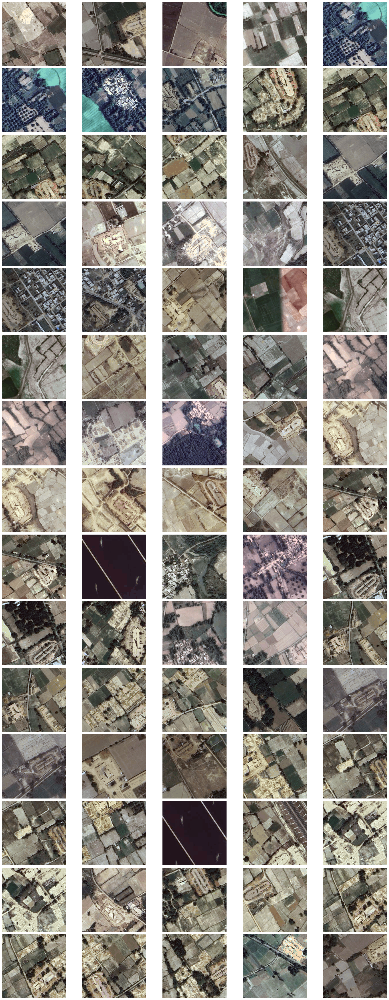

In [17]:
# Filter the images based on the label
label_1_images = images[pred_classes == 1]
label_1_images.cpu().numpy()
# Plot the filtered images
fig, axes = plt.subplots(15, 5, figsize=(25,60))

for i in range(15):
    for j in range(5):
        # Adjust the index calculation to match the desired grid
        index = i * 4 + j
        if index < len(label_1_images):
            # Transpose the dimensions to (32, 32, 3) for RGB image
            image_to_display = label_1_images[index].permute(1, 2, 0)
            image_to_display = (image_to_display - image_to_display.min()) / (image_to_display.max() - image_to_display.min())

            axes[i, j].imshow(image_to_display)
            #put the label
            # axes[i, j].set_title(label_1_images[index].item())
            axes[i, j].axis('off')
        else:
            # If there are fewer than 20 images, remove empty subplots
            fig.delaxes(axes[i, j])
plt.tight_layout()
plt.show()